# Import library

In [1]:
import copy
import numpy as np
import pandas as pd
from sklearn.preprocessing import OneHotEncoder
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error
from sklearn.linear_model import LinearRegression
from sklearn import metrics
import pickle


# Load data

In [2]:
df = pd.read_csv('/kaggle/input/car-price-vn/data.csv')
df_car = pd.read_json("/kaggle/input/new-car/page_0_350.json")

# Data overview

In [3]:
df_car.head()

,name,price,type,assemble_place
0,Skoda Kodiaq Ambition 1.4 TSI Tur - 2023,1 Tỷ 169 Triệu,Xe mới 2023,Xe nhập khẩu
1,Mitsubishi Xpander 1.5 AT - 2023,534 Triệu,Xe mới 2023,Xe nhập khẩu
2,MG ZS Luxury 1.5 AT 2WD - 2023,530 Triệu,Xe mới 2023,Xe nhập khẩu
3,Volkswagen Teramont 2.0 AT - 2023,2 Tỷ 99 Triệu,Xe mới 2023,Xe nhập khẩu
4,Lexus LX 600 Vip - 2023,9 Tỷ 610 Triệu,Xe mới 2023,Xe nhập khẩu


In [4]:
def describle_data(df):
    print('Shape of data:\n', df.shape)
    print('--'*20)
    print('Columns of data: \n', df.columns)
    print('--'*20)
    print('Data types of data: \n', df.dtypes)
    print('--'*20)
    print('Missing values of data: \n', df.isna().sum())
    print('--'*20)
    print('Describe data: \n', df.describe())
    print('--'*20)
    print('Info data: \n', df.info())
describle_data(df)

Shape of data:
 (26956, 11)
----------------------------------------
Columns of data: 
 Index(['car_name', 'year', 'price', 'assemble_place', 'series', 'driven kms',
       'num_of_door', 'num_of_seat', 'engine_type', 'transmission', 'url'],
      dtype='object')
----------------------------------------
Data types of data: 
 car_name           object
year               object
price              object
assemble_place     object
series             object
driven kms        float64
num_of_door       float64
num_of_seat       float64
engine_type        object
transmission       object
url                object
dtype: object
----------------------------------------
Missing values of data: 
 car_name          38
year              11
price             11
assemble_place    11
series            11
driven kms        11
num_of_door       11
num_of_seat       11
engine_type       11
transmission      11
url               11
dtype: int64
----------------------------------------
Describe data: 
     

In [5]:
describle_data(df_car)

Shape of data:
 (5740, 4)
----------------------------------------
Columns of data: 
 Index(['name', 'price', 'type', 'assemble_place'], dtype='object')
----------------------------------------
Data types of data: 
 name              object
price             object
type              object
assemble_place    object
dtype: object
----------------------------------------
Missing values of data: 
 name              0
price             0
type              0
assemble_place    0
dtype: int64
----------------------------------------
Describe data: 
                                        name        price           type  \
count                                  5740         5740           5740   
unique                                  730         1061              6   
top      Ford Ranger XLS 2.0L 4x2 AT - 2023   799 Triệu    Xe mới 2023    
freq                                    152           75           5295   

       assemble_place  
count            5740  
unique              2  
top 

# Xóa bỏ những xe bị trùng lặp

In [6]:
df

,car_name,year,price,assemble_place,series,driven kms,num_of_door,num_of_seat,engine_type,transmission,url
0,LandRover Range Rover HSE 3.0,2015,2 Tỷ 700 Triệu,Nhập khẩu,SUV,65000.0,5.0,5.0,Xăng,Số tự động,https://bonbanh.com/xe-landrover-range_rover-h...
1,Mitsubishi Outlander 2.0 CVT Premium,2018,666 Triệu,Lắp ráp trong nước,SUV,50000.0,5.0,7.0,Xăng,Số tự động,https://bonbanh.com/xe-mitsubishi-outlander-2....
2,Mazda 3 1.5L Luxury,2019,490 Triệu,Lắp ráp trong nước,Sedan,51000.0,4.0,5.0,Xăng,Số tự động,https://bonbanh.com/xe-mazda-3-1.5l-luxury-201...
3,Mazda 2 1.5 AT,2015,365 Triệu,Lắp ráp trong nước,Sedan,38000.0,4.0,5.0,Xăng,Số tự động,https://bonbanh.com/xe-mazda-2-1.5-at-2015-491...
4,Suzuki Swift GLX 1.2 AT,2021,565 Triệu,Nhập khẩu,Hatchback,6000.0,5.0,5.0,Xăng,Số tự động,https://bonbanh.com/xe-suzuki-swift-glx-1.2-at...
...,...,...,...,...,...,...,...,...,...,...,...
26951,Suzuki Swift GLX 1.2 AT,2021,515 Triệu,Nhập khẩu,Hatchback,3000.0,5.0,5.0,Xăng,Số tự động,https://bonbanh.com/xe-suzuki-swift-glx-1.2-at...
26952,Hyundai i10 Grand 1.2 AT,2020,385 Triệu,Lắp ráp trong nước,Hatchback,20000.0,5.0,5.0,Xăng,Số tự động,https://bonbanh.com/xe-hyundai-i10-grand-1.2-a...
26953,Toyota Rush 1.5S AT,2019,679 Triệu,Nhập khẩu,SUV,60000.0,5.0,7.0,Xăng,Số tự động,https://bonbanh.com/xe-toyota-rush-1.5s-at-201...
26954,Lexus GX 460,2010,1 Tỷ 500 Triệu,Nhập khẩu,SUV,60000.0,5.0,7.0,Xăng,Số tự động,https://bonbanh.com/xe-lexus-gx-460-2010-4557366


In [7]:
df.drop_duplicates(subset=['url'], inplace=True)

describle_data(df)

Shape of data:
 (25157, 11)
----------------------------------------
Columns of data: 
 Index(['car_name', 'year', 'price', 'assemble_place', 'series', 'driven kms',
       'num_of_door', 'num_of_seat', 'engine_type', 'transmission', 'url'],
      dtype='object')
----------------------------------------
Data types of data: 
 car_name           object
year               object
price              object
assemble_place     object
series             object
driven kms        float64
num_of_door       float64
num_of_seat       float64
engine_type        object
transmission       object
url                object
dtype: object
----------------------------------------
Missing values of data: 
 car_name          35
year               1
price              1
assemble_place     1
series             1
driven kms         1
num_of_door        1
num_of_seat        1
engine_type        1
transmission       1
url                1
dtype: int64
----------------------------------------
Describe data: 
     

# Chuyển đổi kiểu dữ liệu cho các cột year, price sang kiểu số thực để có thể thực hiện các phép tính toán

Year

In [8]:
def process_year_colum(year):
    if year.isdigit():
        return float(year)
    else:
        return 0
df['year'] = df['year'].astype(str).apply(process_year_colum)
df
describle_data(df)

Shape of data:
 (25157, 11)
----------------------------------------
Columns of data: 
 Index(['car_name', 'year', 'price', 'assemble_place', 'series', 'driven kms',
       'num_of_door', 'num_of_seat', 'engine_type', 'transmission', 'url'],
      dtype='object')
----------------------------------------
Data types of data: 
 car_name           object
year              float64
price              object
assemble_place     object
series             object
driven kms        float64
num_of_door       float64
num_of_seat       float64
engine_type        object
transmission       object
url                object
dtype: object
----------------------------------------
Missing values of data: 
 car_name          35
year               0
price              1
assemble_place     1
series             1
driven kms         1
num_of_door        1
num_of_seat        1
engine_type        1
transmission       1
url                1
dtype: int64
----------------------------------------
Describe data: 
     

Price

In [9]:
df.isna().sum()
df.dropna(subset=['car_name'], inplace=True)

In [10]:
def process_price(price):
    try:
        if price.find('Tỷ') != -1:
            ty= price.split('Tỷ')[0]
            trieu = price.split('Tỷ')[1]
            trieu = trieu.split('Triệu')[0]
            return float(ty)*1000000000 + float(trieu)*1000000
        elif price.find('Triệu') != -1:
            trieu = price.split('Triệu')[0]
            trieu = trieu.replace(' ','')
            return float(trieu)*1000000
        else:
            return 0
    except:
        return 0
df['price'] = df['price'].astype(str).apply(process_price)

In [11]:
df['driven kms'].describe()
# lấy ra các xe có số km đi được nhỏ hơn 1000km
print(df[df['driven kms'] < 1000]['url'])

57       https://bonbanh.com/xe-mercedes_benz-c_class-c...
64       https://bonbanh.com/xe-mercedes_benz-c_class-c...
89       https://bonbanh.com/xe-mercedes_benz-c_class-c...
153      https://bonbanh.com/xe-gaz-khac-sadko-2002-493...
169      https://bonbanh.com/xe-kia-morning-slx-1.0-at-...
                               ...                        
26814    https://bonbanh.com/xe-mazda-3-1.5-at-2015-483...
26829    https://bonbanh.com/xe-toyota-camry-2.5hv-2022...
26889    https://bonbanh.com/xe-mercedes_benz-glc-300-4...
26890    https://bonbanh.com/xe-mercedes_benz-e_class-e...
26894    https://bonbanh.com/xe-toyota-venza-2.7-2009-4...
Name: url, Length: 627, dtype: object


In [12]:
#drop all rows with driven kms < 1000, nan values in all columns
df.drop(df[df['driven kms'] < 1000].index, inplace=True)
df.dropna(inplace=True)
df.isna().sum()

car_name          0
year              0
price             0
assemble_place    0
series            0
driven kms        0
num_of_door       0
num_of_seat       0
engine_type       0
transmission      0
url               0
dtype: int64

In [13]:
df['price'].describe()


count    2.449400e+04
mean     1.059076e+09
std      1.652340e+09
min      0.000000e+00
25%      3.880000e+08
50%      5.600000e+08
75%      9.350000e+08
max      3.860000e+10
Name: price, dtype: float64

# Xử lý các cột dạng nhãn

Car_name có hai phần là hãng xe và tên xe, ta sẽ tách ra thành hai cột là brand và model


In [14]:
df['brand'] = df['car_name'].str.split().str[0]


In [15]:




df['brand'].value_counts()

brand
Toyota        4673
Hyundai       2775
Mercedes      2732
Kia           2628
Ford          2198
              ... 
Haima            1
Scion            1
Dothanh          1
B                1
Brilliance       1
Name: count, Length: 84, dtype: int64

In [16]:
df.head()

,car_name,year,price,assemble_place,series,driven kms,num_of_door,num_of_seat,engine_type,transmission,url,brand
0,LandRover Range Rover HSE 3.0,2015.0,2.700000e+09,Nhập khẩu,SUV,65000.0,5.0,5.0,Xăng,Số tự động,https://bonbanh.com/xe-landrover-range_rover-h...,LandRover
1,Mitsubishi Outlander 2.0 CVT Premium,2018.0,6.660000e+08,Lắp ráp trong nước,SUV,50000.0,5.0,7.0,Xăng,Số tự động,https://bonbanh.com/xe-mitsubishi-outlander-2....,Mitsubishi
2,Mazda 3 1.5L Luxury,2019.0,4.900000e+08,Lắp ráp trong nước,Sedan,51000.0,4.0,5.0,Xăng,Số tự động,https://bonbanh.com/xe-mazda-3-1.5l-luxury-201...,Mazda
3,Mazda 2 1.5 AT,2015.0,3.650000e+08,Lắp ráp trong nước,Sedan,38000.0,4.0,5.0,Xăng,Số tự động,https://bonbanh.com/xe-mazda-2-1.5-at-2015-491...,Mazda
4,Suzuki Swift GLX 1.2 AT,2021.0,5.650000e+08,Nhập khẩu,Hatchback,6000.0,5.0,5.0,Xăng,Số tự động,https://bonbanh.com/xe-suzuki-swift-glx-1.2-at...,Suzuki


# Xử lý các dữ liệu bị thiếu hoặc sai


Xử lý cột year

In [17]:
car_before_1990 = df[df['year'] < 1990]
print('Number of car before 1990: ', car_before_1990.shape[0])
print('Number of car before 1990: ', car_before_1990['year'].value_counts())

Number of car before 1990:  197
Number of car before 1990:  year
0.0      195
200.0      1
700.0      1
Name: count, dtype: int64


Điền các giá trị sai trong cột year bằng giá trị xuất hiện nhiều nhất trong cột year

In [18]:
df['year'] = df['year'].apply(lambda x: df['year'].value_counts().index[0] if x < 1990 else x)

Cột price: các giá trị bằng = 0 sẽ được thay thế bằng giá trung bình của các xe sản xuất trong năm đó

In [19]:
df['price'] = df['price'].apply(lambda x: df[df['year'] == x]['price'].mean() if x == 0 else x)
df['price'].describe()

count    2.422200e+04
mean     1.070969e+09
std      1.657754e+09
min      1.500000e+07
25%      3.950000e+08
50%      5.650000e+08
75%      9.450000e+08
max      3.860000e+10
Name: price, dtype: float64

Cột num_of_door
Thông thường các xe có tối đa 5 - 6 cửa, với những giá trị sai ta sẽ điền bằng giá trị xuất hiện nhiều nhất trong cột num_of_door

In [20]:
df['num_of_door'] = df['num_of_door'].apply(lambda x: df['num_of_door'].value_counts().index[0] if x > 6 else x)

Cột brand

In [21]:
df['brand'].value_counts()

brand
Toyota        4673
Hyundai       2775
Mercedes      2732
Kia           2628
Ford          2198
              ... 
Haima            1
Scion            1
Dothanh          1
B                1
Brilliance       1
Name: count, Length: 84, dtype: int64

Cột brand có một số hãng có số lượng xe rất ít hoặc bị thiếu, ta sẽ gộp các hãng xe này thành một nhóm là 'other'
Nếu số xe của hãng đó nhỏ hơn 10 thì sẽ gộp vào nhóm 'Other'

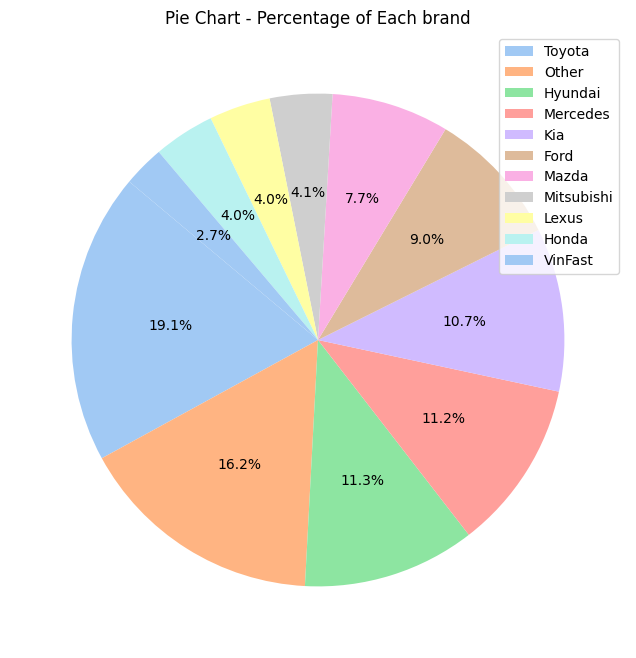

In [22]:
def draw_size_brand_pie(df,col,threshold):
    df_fake = copy.deepcopy(df)
    car_count = df_fake[col].value_counts()
    small_brands = car_count[car_count < threshold].index.tolist()
    df_fake[col] = df_fake[col].apply(lambda x: 'Other' if x in small_brands else x)
    df_fake[col].fillna('Other', inplace=True)
    brand_counts = df_fake[col].value_counts()
    total_brands = len(df_fake[col])
    brand_percentages = (brand_counts / total_brands) * 100

    # Create a dictionary to map brand names to average prices
    brand_avg_price = df_fake.groupby(col)['price'].mean().to_dict()

    # Get a categorical color palette
    palette = sns.color_palette('pastel', n_colors=len(brand_percentages))

    # Plotting
    plt.figure(figsize=(20, 8))
    colors = [palette[i] for i, brand in enumerate(brand_percentages.index)]
    plt.pie(brand_percentages, labels=None, autopct='%1.1f%%', startangle=140, colors=colors)

    # Adding legend
    plt.legend(brand_percentages.index, loc='upper right')

    # Adding title
    plt.title('Pie Chart - Percentage of Each ' + str(col))

    # Show the plot
    plt.show()
def draw_size_brand_linear(df,threshold):
    df_fake = copy.deepcopy(df)
    car_count = df_fake[col].value_counts()
    small_brands = car_count[car_count < threshold].index.tolist()
    df_fake[col] = df_fake[col].apply(lambda x: 'Other' if x in small_brands else x)
    df_fake[col].fillna('Other', inplace=True)
    
    brand_counts = df_fake[col].value_counts()
    total_brands = len(df_fake[col])
    brand_percentages = (brand_counts / total_brands) * 100

    # Plotting
    plt.figure(figsize=(10, 6))
    brand_percentages.plot(kind='bar', color='skyblue', edgecolor='black')
    plt.title('Percentage of Each Car ' +str(col))
    plt.xlabel('Car Brand')
    plt.ylabel('Percentage')
    plt.xticks(rotation=45, ha='right')  # Rotate x-axis labels for better visibility
    plt.tight_layout()

    # Show the plot
    plt.show()
draw_size_brand_pie(df,'brand',600)

In [23]:
threshold = 100
car_count = df['brand'].value_counts()
small_brands = car_count[car_count < threshold].index.tolist()
df['brand'] = df['brand'].apply(lambda x: 'Other' if x in small_brands else x)
df['brand'].fillna('Other', inplace=True)
brand_counts = df['brand'].value_counts()
total_brands = len(df['brand'])
brand_percentages = (brand_counts / total_brands) * 100

In [24]:
# in ra tất cả brand
# sắp xếp theo thứ tự giảm dần về giá trung bình




In [25]:
# def car_band(x):
#     if x in ['Land', 'Lamborghini', 'Jaguar', 'BMW', 'Mercedes', 'Porsche','Jeep',
#        'Audi', 'Bentley','Mini','LandRover','Lexus','Maserati','Rolls','Ferrari','Aston','Lincoln','Maserati','Cadillac']:
#         return 'HIGH END CAR'    
#     elif x in ['Ford',
#             'Skoda',
#          'Mahindra',
#             'Force',
#        'Mitsubishi',
#            'Toyota',
#             'ISUZU',
#            'Volvo',
#           'Isuzu','Other']:
#         return 'MIDDLE RANGE CAR'
#     else:
#         return 'LOW END CAR'
# df['brand']=df['brand'].apply(car_band)
# def car_band(x):
#     if x in ['Rolls', 'Bentley', 'Ferrari','Lincoln','Porsche','LandRover','Lexus','Jeep']:
#         return 'LUXURY CAR'
#     elif x in ['Maserati', 'Cadillac', 'Lincoln', 'Mercedes', 'Audi', 'BMW', 'Volvo']:
#         return 'PREMIUM CAR'
#     elif x in ['VW', 'Seat', 'Ford', 'Opel','VinFast','Mazda','Honda','Hyundai','Kia','Chevrolet','Toyota','Suzuki','Nissan','Renault','Other']:
#         return 'VOLUME CAR'
#     else:
#         return 'LOW-PRICE CAR'
# def car_band(x):
#     if x in ['Rolls-Royce', 'Bentley', 'Lincoln', 'Land Rover', 'Porsche', 'Maserati', 'Lexus', 'Jeep', 'Cadillac']:
#         return 'LUXURY CAR'
#     elif x in ['Mini', 'BMW', 'Audi', 'Volvo', 'Mercedes-Benz', 'Infiniti', 'Jaguar','Other']:
#         return 'PREMIUM CAR'
#     elif x in ['Subaru', 'Volkswagen', 'Peugeot', 'Toyota', 'Ford', 'VinFast', 'Mazda', 'Hyundai', 'Honda']:
#         return 'VOLUME CAR'
#     else:
#         return 'LOW-PRICE CAR'
def car_band(x):
    if x in ['Rolls', 'Bentley', 'Lincoln', 'LandRover', 'Porsche', 'Maserati', 'Lexus', 'Jeep', 'Cadillac']:
        return 'LUXURY'
    elif x in ['Other', 'Volvo', 'Mercedes', 'Infiniti', 'Jaguar', 'Mini', 'BMW', 'Audi']:
        return 'PREMIUM'
    elif x in ['Subaru', 'Volkswagen', 'Peugeot', 'Toyota', 'Ford', 'VinFast', 'Mazda', 'Hyundai', 'Honda','MG','Mitsubishi']:
        return 'VOLUME'
    else:
        return 'LOWEND'

df['brand_segment'] = df['brand'].apply(car_band)

df['brand_segment'].value_counts()


brand_segment
VOLUME     14414
PREMIUM     4303
LOWEND      3992
LUXURY      1785
Name: count, dtype: int64

Cột series: ta thấy các giá trị của cột series có giá trị nan, ta sẽ điền các giá trị này bằng giá trị xuất hiện nhiều nhất trong cột series

In [26]:
df['series'] = df['series'].apply(lambda x: df['series'].value_counts().index[0] if x == '-' else x)
df['series'].fillna(df['series'].value_counts().index[0], inplace=True)

In [27]:
df['series'].isna().sum()

0

Cột engine_type: ta thấy có một vài giá trị bị thiếu, ta sẽ điền các giá trị này bằng giá trị xuất hiện nhiều nhất trong cột engine_type

In [28]:
df['engine_type'] = df['engine_type'].apply(lambda x: df['engine_type'].value_counts().index[0] if x == '-' else x)
df['engine_type'].fillna(df['engine_type'].value_counts().index[0], inplace=True)

In [29]:
df['engine_type'].isna().sum()

0

Cột transmission tương tự cột engine_type

In [30]:
df['transmission'] = df['transmission'].apply(lambda x: df['transmission'].value_counts().index[0] if x == '-' else x)
df['transmission'].fillna(df['transmission'].value_counts().index[0], inplace=True)

In [31]:
df['transmission'].isna().sum()

0

# Trực quan hóa dữ liệu

Tìm hiểu về mối liên hệ giữa giá xe và các thuộc tính khác

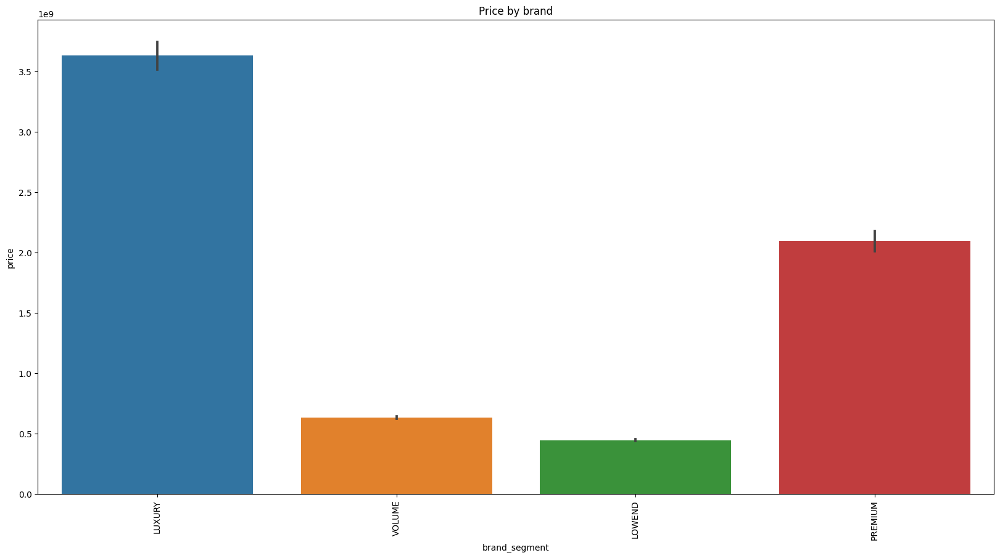

In [32]:
#vẽ price theo brand, series,year
plt.figure(figsize=(20, 10))
sns.barplot(x='brand_segment', y='price', data=df)
plt.title('Price by brand')
plt.xticks(rotation=90)
plt.show()

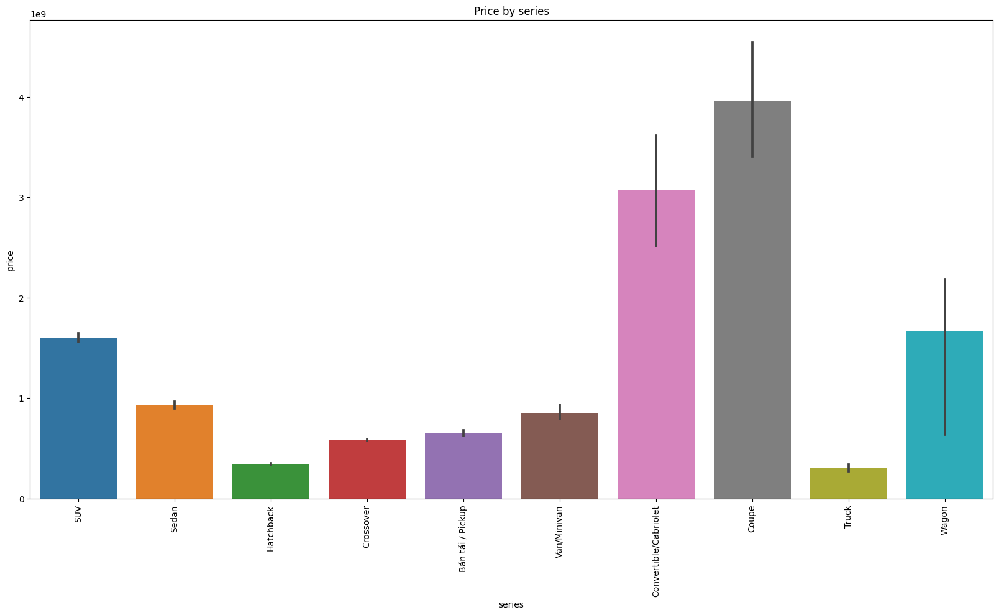

In [33]:
plt.figure(figsize=(20, 10))
sns.barplot(x='series', y='price', data=df)
plt.title('Price by series')
plt.xticks(rotation=90)
plt.show()

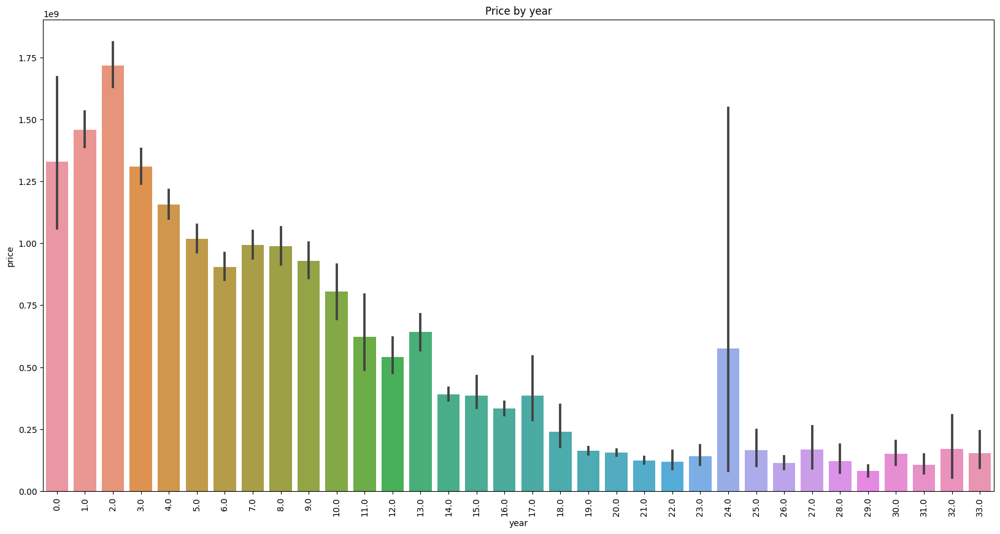

In [34]:
plt.figure(figsize=(20, 10))
#đổi năm sản xuất thành tuổi xe
df['year'] = 2023 - df['year']
sns.barplot(x='year', y='price', data=df)
plt.title('Price by year')
plt.xticks(rotation=90)
plt.show()

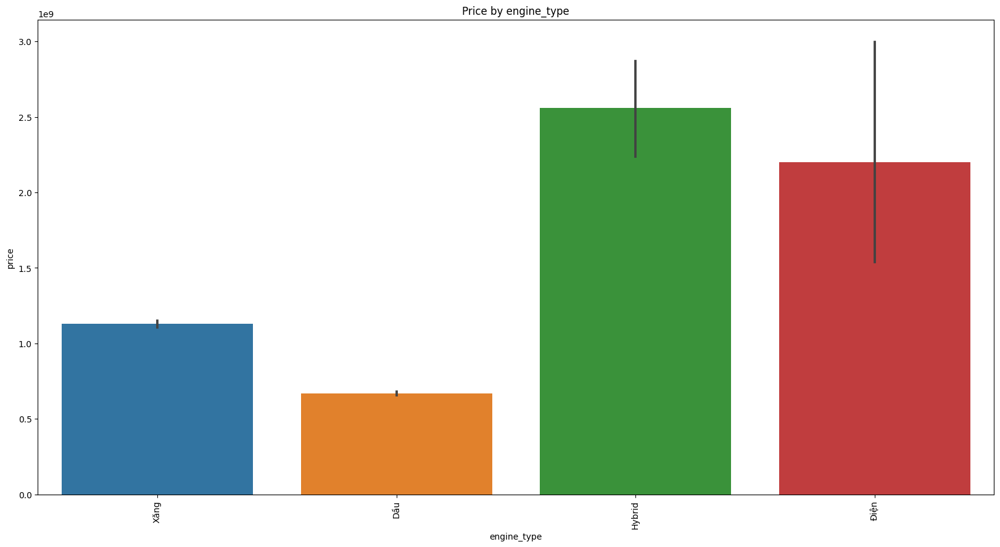

In [35]:
plt.figure(figsize=(20, 10))
sns.barplot(x='engine_type', y='price', data=df)
plt.title('Price by engine_type')
plt.xticks(rotation=90)
plt.show()


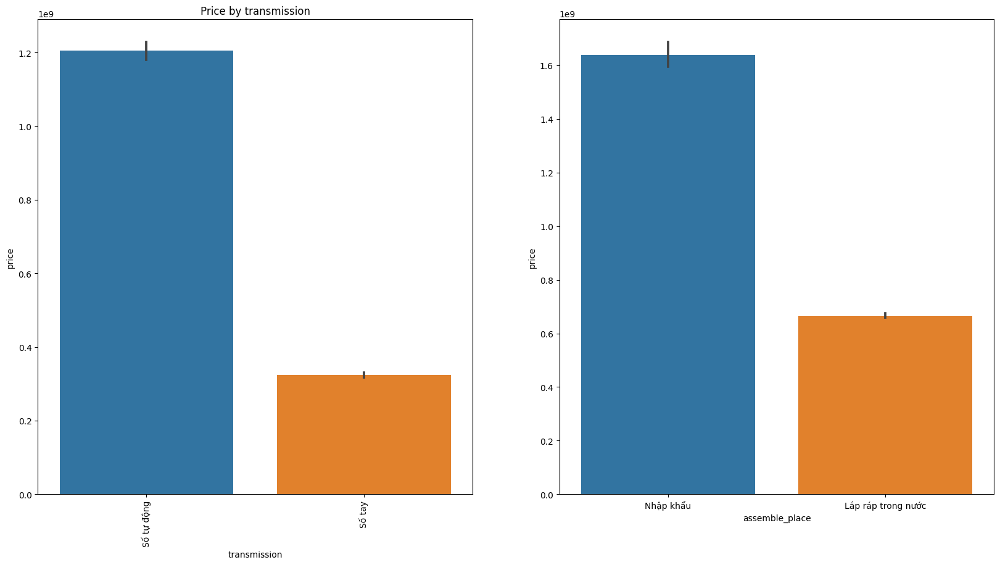

In [36]:
plt.figure(figsize=(20, 10))
plt.subplot(1, 2, 1)
sns.barplot(x='transmission', y='price', data=df)
plt.title('Price by transmission')
plt.xticks(rotation=90)
plt.subplot(1, 2, 2)
sns.barplot(x='assemble_place', y='price', data=df)
plt.show()

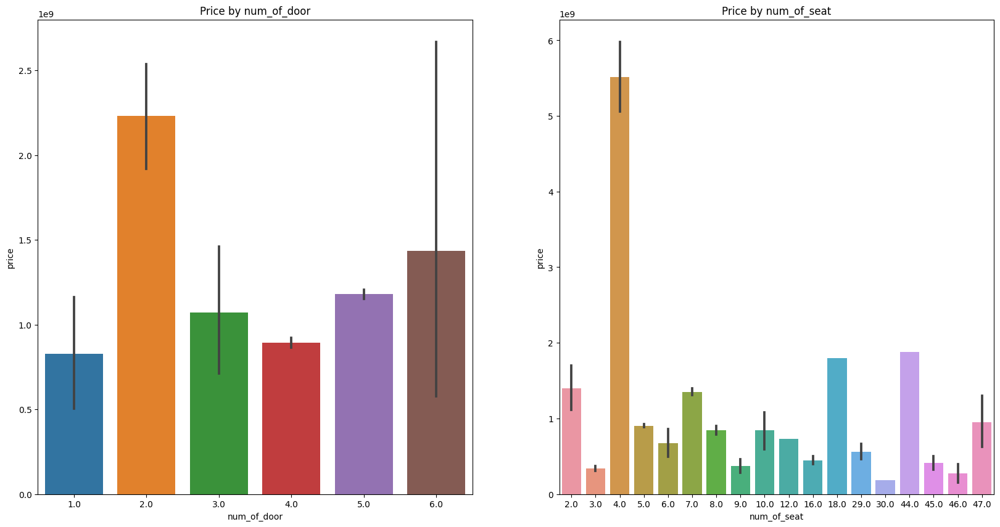

In [37]:
plt.figure(figsize=(20, 10))
plt.subplot(1, 2, 1)
sns.barplot(x='num_of_door', y='price', data=df)
plt.title('Price by num_of_door')
plt.subplot(1, 2, 2)
sns.barplot(x='num_of_seat', y='price', data=df)
plt.title('Price by num_of_seat')
plt.show()

# Tìm hiểu về mối liên hệ giữa các thuộc tính với nhau

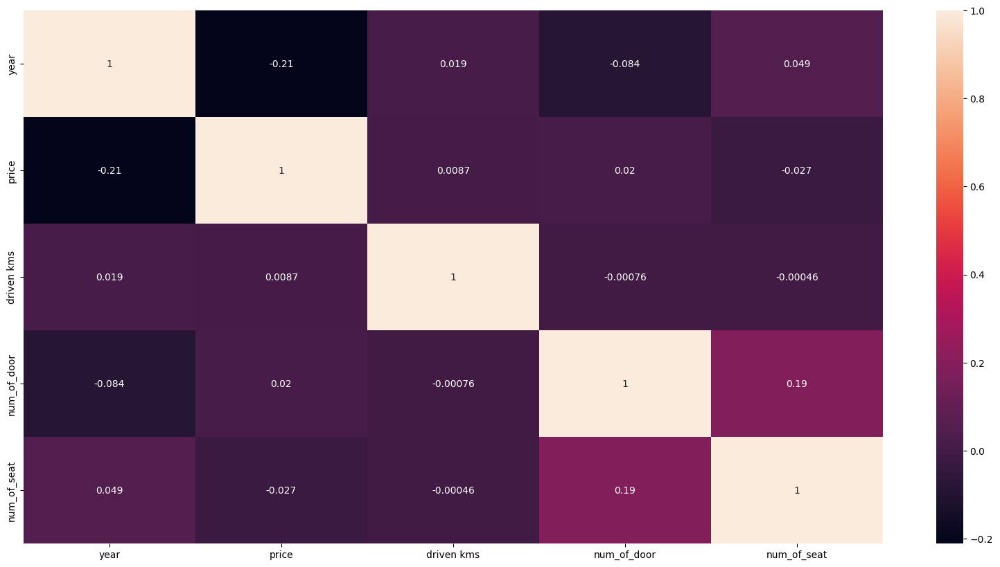

In [38]:
#vẽ biểu đồ nhiệt giữa price và các thuộc tính trừ model
plt.figure(figsize=(20, 10))
numeric_cols = df.select_dtypes(include=['float64', 'int64'])
sns.heatmap(numeric_cols.corr(), annot=True)
plt.show()



In [39]:
df


,car_name,year,price,assemble_place,series,driven kms,num_of_door,num_of_seat,engine_type,transmission,url,brand,brand_segment
0,LandRover Range Rover HSE 3.0,8.0,2.700000e+09,Nhập khẩu,SUV,65000.0,5.0,5.0,Xăng,Số tự động,https://bonbanh.com/xe-landrover-range_rover-h...,LandRover,LUXURY
1,Mitsubishi Outlander 2.0 CVT Premium,5.0,6.660000e+08,Lắp ráp trong nước,SUV,50000.0,5.0,7.0,Xăng,Số tự động,https://bonbanh.com/xe-mitsubishi-outlander-2....,Mitsubishi,VOLUME
2,Mazda 3 1.5L Luxury,4.0,4.900000e+08,Lắp ráp trong nước,Sedan,51000.0,4.0,5.0,Xăng,Số tự động,https://bonbanh.com/xe-mazda-3-1.5l-luxury-201...,Mazda,VOLUME
3,Mazda 2 1.5 AT,8.0,3.650000e+08,Lắp ráp trong nước,Sedan,38000.0,4.0,5.0,Xăng,Số tự động,https://bonbanh.com/xe-mazda-2-1.5-at-2015-491...,Mazda,VOLUME
4,Suzuki Swift GLX 1.2 AT,2.0,5.650000e+08,Nhập khẩu,Hatchback,6000.0,5.0,5.0,Xăng,Số tự động,https://bonbanh.com/xe-suzuki-swift-glx-1.2-at...,Suzuki,LOWEND
...,...,...,...,...,...,...,...,...,...,...,...,...,...
26898,Suzuki Swift GLX 1.2 AT,2.0,5.150000e+08,Nhập khẩu,Hatchback,3000.0,5.0,5.0,Xăng,Số tự động,https://bonbanh.com/xe-suzuki-swift-glx-1.2-at...,Suzuki,LOWEND
26899,Hyundai i10 Grand 1.2 AT,3.0,3.850000e+08,Lắp ráp trong nước,Hatchback,20000.0,5.0,5.0,Xăng,Số tự động,https://bonbanh.com/xe-hyundai-i10-grand-1.2-a...,Hyundai,VOLUME
26900,Toyota Rush 1.5S AT,4.0,6.790000e+08,Nhập khẩu,SUV,60000.0,5.0,7.0,Xăng,Số tự động,https://bonbanh.com/xe-toyota-rush-1.5s-at-201...,Toyota,VOLUME
26901,Lexus GX 460,13.0,1.500000e+09,Nhập khẩu,SUV,60000.0,5.0,7.0,Xăng,Số tự động,https://bonbanh.com/xe-lexus-gx-460-2010-4557366,Lexus,LUXURY


# Mã hóa các cột dạng nhãn thành dạng số để có thể sử dụng cho mô hình học máy

Cột assemble_place chỉ có 2 giá trị là 'Lắp ráp trong nước' và 'Nhập khẩu', ta sẽ mã hóa thành 0 và 1

In [40]:
df['assemble_place'] = df['assemble_place'].map({'Lắp ráp trong nước': 0, 'Nhập khẩu': 1})

In [41]:
df['assemble_place'].value_counts()

assemble_place
0    14230
1    10264
Name: count, dtype: int64

Cột brand sẽ được mã hóa bằng phương pháp One-hot encoding

# Biểu đồ tiếp theo : 

In [42]:
df['brand'].value_counts()

brand
Toyota        4673
Hyundai       2775
Mercedes      2732
Kia           2628
Ford          2198
Mazda         1890
Mitsubishi    1003
Lexus          986
Honda          981
Other          725
VinFast        663
Chevrolet      560
BMW            492
LandRover      405
Porsche        394
Nissan         335
Suzuki         278
Audi           250
Peugeot        231
Daewoo         191
Volvo          104
Name: count, dtype: int64

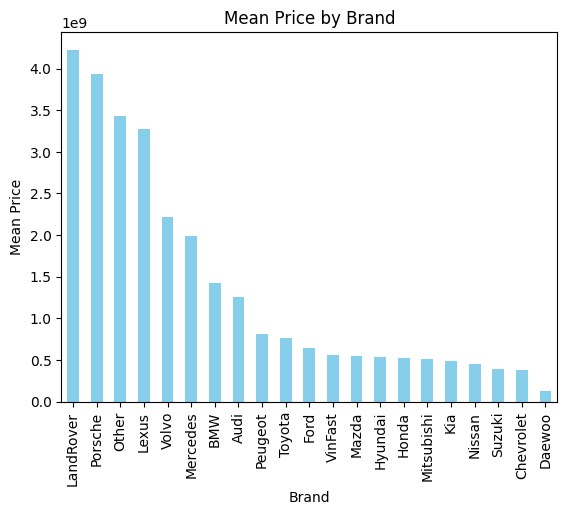

In [43]:
mean_price_by_brand = df.groupby('brand')['price'].mean()
mean_price_by_brand = mean_price_by_brand.sort_values(ascending=False)
# Plotting the bar chart
mean_price_by_brand.plot(kind='bar', color='skyblue')
plt.title('Mean Price by Brand')
plt.xlabel('Brand')
plt.ylabel('Mean Price')
plt.show()

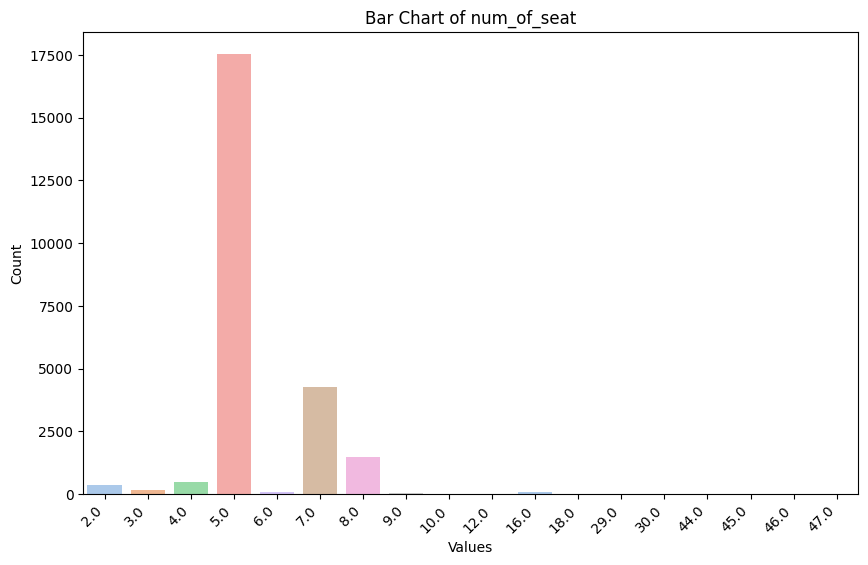

In [44]:
def plot_bar_chart(df, column_name):
    # Assuming you want to count the occurrences of each value in the column
    value_counts = df[column_name].value_counts()

    # Create a color palette with a different color for each unique value
    colors = sns.color_palette("pastel", len(value_counts))

    # Create a bar plot using Seaborn
    plt.figure(figsize=(10, 6))  # Adjust the figure size as needed
    bar_plot = sns.barplot(x=value_counts.index, y=value_counts.values, palette=colors)

    # Add labels and title
    bar_plot.set(xlabel='Values', ylabel='Count', title=f'Bar Chart of {column_name}')

    # Rotate x-axis labels for better readability
    plt.xticks(rotation=45, ha='right')

    # Show the plot
    plt.show()
plot_bar_chart(df,'num_of_seat')

In [45]:
len(df[df['year'] <=  2]['car_name'].value_counts())


480

In [46]:
df

,car_name,year,price,assemble_place,series,driven kms,num_of_door,num_of_seat,engine_type,transmission,url,brand,brand_segment
0,LandRover Range Rover HSE 3.0,8.0,2.700000e+09,1,SUV,65000.0,5.0,5.0,Xăng,Số tự động,https://bonbanh.com/xe-landrover-range_rover-h...,LandRover,LUXURY
1,Mitsubishi Outlander 2.0 CVT Premium,5.0,6.660000e+08,0,SUV,50000.0,5.0,7.0,Xăng,Số tự động,https://bonbanh.com/xe-mitsubishi-outlander-2....,Mitsubishi,VOLUME
2,Mazda 3 1.5L Luxury,4.0,4.900000e+08,0,Sedan,51000.0,4.0,5.0,Xăng,Số tự động,https://bonbanh.com/xe-mazda-3-1.5l-luxury-201...,Mazda,VOLUME
3,Mazda 2 1.5 AT,8.0,3.650000e+08,0,Sedan,38000.0,4.0,5.0,Xăng,Số tự động,https://bonbanh.com/xe-mazda-2-1.5-at-2015-491...,Mazda,VOLUME
4,Suzuki Swift GLX 1.2 AT,2.0,5.650000e+08,1,Hatchback,6000.0,5.0,5.0,Xăng,Số tự động,https://bonbanh.com/xe-suzuki-swift-glx-1.2-at...,Suzuki,LOWEND
...,...,...,...,...,...,...,...,...,...,...,...,...,...
26898,Suzuki Swift GLX 1.2 AT,2.0,5.150000e+08,1,Hatchback,3000.0,5.0,5.0,Xăng,Số tự động,https://bonbanh.com/xe-suzuki-swift-glx-1.2-at...,Suzuki,LOWEND
26899,Hyundai i10 Grand 1.2 AT,3.0,3.850000e+08,0,Hatchback,20000.0,5.0,5.0,Xăng,Số tự động,https://bonbanh.com/xe-hyundai-i10-grand-1.2-a...,Hyundai,VOLUME
26900,Toyota Rush 1.5S AT,4.0,6.790000e+08,1,SUV,60000.0,5.0,7.0,Xăng,Số tự động,https://bonbanh.com/xe-toyota-rush-1.5s-at-201...,Toyota,VOLUME
26901,Lexus GX 460,13.0,1.500000e+09,1,SUV,60000.0,5.0,7.0,Xăng,Số tự động,https://bonbanh.com/xe-lexus-gx-460-2010-4557366,Lexus,LUXURY


In [47]:
df['series'].value_counts()

series
Sedan                    8800
SUV                      8283
Hatchback                2479
Crossover                1962
Bán tải / Pickup       1698
Van/Minivan               833
Coupe                     170
Truck                     170
Convertible/Cabriolet      95
Wagon                       4
Name: count, dtype: int64

In [48]:
!pip install git+https://github.com/skrub-data/skrub.git

  Cloning https://github.com/skrub-data/skrub.git to /tmp/pip-req-build-2lpqed2p
  Running command git clone --filter=blob:none --quiet https://github.com/skrub-data/skrub.git /tmp/pip-req-build-2lpqed2p
  Resolved https://github.com/skrub-data/skrub.git to commit af6a9b8295310fbb2566cb4df3d681bf868aba74
  Installing build dependencies ... - \ | / done
  Getting requirements to build wheel ... - done
  Preparing metadata (pyproject.toml) ... - done
  Obtaining dependency information for packaging>=23.1 from https://files.pythonhosted.org/packages/ec/1a/610693ac4ee14fcdf2d9bf3c493370e4f2ef7ae2e19217d7a237ff42367d/packaging-23.2-py3-none-any.whl.metadata
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 53.0/53.0 kB 2.7 MB/s eta 0:00:00
  Created wheel for skrub: filename=skrub-0.1.0-py3-none-any.whl size=141660 sha256=784de4c9963f142ca4fee67bfc707830cdc2f5087cf4a19c910120e05d2a6e59
  Stored in directory: /tmp/pip-ephem-wheel-cache-syp0cbvh/wheels/4e/91/ee/4342e6a6d0ab28090d14038fa

In [49]:
!pip install scipy==1.9.3

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 33.7/33.7 MB 36.4 MB/s eta 0:00:00
  Attempting uninstall: scipy
    Found existing installation: scipy 1.11.4
    Uninstalling scipy-1.11.4:
      Successfully uninstalled scipy-1.11.4
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
featuretools 1.28.0 requires scipy>=1.10.0, but you have scipy 1.9.3 which is incompatible.
kaggle-environments 1.14.3 requires scipy>=1.11.2, but you have scipy 1.9.3 which is incompatible.
libpysal 4.9.2 requires shapely>=2.0.1, but you have shapely 1.8.5.post1 which is incompatible.
momepy 0.7.0 requires shapely>=2, but you have shapely 1.8.5.post1 which is incompatible.
pymc3 3.11.5 requires numpy<1.22.2,>=1.15.0, but you have numpy 1.24.3 which is incompatible.
pymc3 3.11.5 requires scipy<1.8.0,>=1.7.3, but you have scipy 1.9.3 which is incompatible.
spopt 0.6.0 requires shapely>=2

In [50]:
df.dropna(subset=['price'], inplace=True)
df.reset_index(drop=True, inplace=True)

X_without_car = df.drop(['price','url','car_name'], axis=1)
X_with_car = df.drop(['price','url'], axis=1)
y = df['price']


In [51]:
from sklearn.ensemble import HistGradientBoostingRegressor
from sklearn.pipeline import make_pipeline
from sklearn.linear_model import LinearRegression
from sklearn.linear_model import LinearRegression
from sklearn.linear_model import Ridge
from sklearn.linear_model import Lasso
from sklearn.linear_model import ElasticNet
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.svm import SVR
from sklearn.neighbors import KNeighborsRegressor

from xgboost import XGBRegressor

In [52]:
from skrub import (
    SimilarityEncoder,
    
    MinHashEncoder,
    GapEncoder,
)
import joblib 
from sklearn.model_selection import cross_validate
from sklearn.compose import make_column_transformer
from sklearn.preprocessing import OneHotEncoder
from sklearn.model_selection import cross_val_score
import copy 
def multitest_not_car_name(X,y,model):
    copy_X = copy.deepcopy(X)
    copy_y = copy.deepcopy(y)
    X_train, X_test, y_train, y_test = train_test_split(copy_X, copy_y, test_size=0.2, random_state=42)
    one_hot = OneHotEncoder(handle_unknown="ignore", sparse=False)
#     encoders = {
#         "one-hot": one_hot,
#         "similarity": SimilarityEncoder(),
#     #     "target": TargetEncoder(handle_unknown="ignore"),
#         "minhash": MinHashEncoder(n_components=30),
#         "gap": GapEncoder(n_components=30),
#     }




    all_scores = dict()

#     for name, method in encoders.items():
    encoder = make_column_transformer(
        (one_hot, ['series', 'engine_type', 'transmission', 'brand', 'brand_segment']),
        ("passthrough", ['year', 'assemble_place', 'driven kms', 'num_of_door', 'num_of_seat']),
        # Last but not least, our dirty column
#             (method, ['car_name']),
        remainder="drop",
    )

    pipeline = make_pipeline(encoder, model)
    print(model)
    pipeline.fit(X_train, y_train)
    scoring = {
        'r2': 'r2',
        'neg_mean_squared_error': 'neg_mean_squared_error',
        'neg_mean_absolute_error': 'neg_mean_absolute_error'
    }

    scores = cross_validate(pipeline, X_test, y_test, scoring=scoring)
    print(pipeline.predict(X_test.iloc[10:11]))
    print(y_test.iloc[10])
    

    # Print all metrics
    for metric, values in scores.items():
        if 'time' not in metric:
            print(f"{metric}:  mean: {np.mean(values):.3f}; std: {np.std(values):.3f}")

    print("\n")
    all_scores['one_hot'] = scores
def multitest(X,y,model):
    copy_X = copy.deepcopy(X)
    copy_y = copy.deepcopy(y)
    X_train, X_test, y_train, y_test = train_test_split(copy_X, copy_y, test_size=0.2, random_state=42)
    one_hot = OneHotEncoder(handle_unknown="ignore", sparse=False)
    encoders = {
#         "one-hot": one_hot,
        "similarity": SimilarityEncoder(),
    #     "target": TargetEncoder(handle_unknown="ignore"),
#         "minhash": MinHashEncoder(n_components=30),
#         "gap": GapEncoder(n_components=30),
    }




    all_scores = dict()

    for name, method in encoders.items():
        encoder = make_column_transformer(
            (one_hot, ['series', 'engine_type', 'transmission', 'brand', 'brand_segment']),
            ("passthrough", ['year', 'assemble_place', 'driven kms', 'num_of_door', 'num_of_seat']),
            # Last but not least, our dirty column
            (method, ['car_name']),
            remainder="drop",
        )
    
        pipeline = make_pipeline(encoder, model)
        print(model)
        pipeline.fit(X_train, y_train)
        scoring = {
            'r2': 'r2',
            'neg_mean_squared_error': 'neg_mean_squared_error',
            'neg_mean_absolute_error': 'neg_mean_absolute_error'
        }

        scores = cross_validate(pipeline, X_test, y_test, scoring=scoring,cv =5)
        print(pipeline.predict(X_test.iloc[10:50]))
        print(y_test.iloc[10:50])
        
        print
        print(f"{name} encoding")

        # Print all metrics
#         for metric, values in scores.items():
#             if 'absolute' in metric:
#                 print(f"{metric}: mean: {np.mean(values) / np.sqrt(len(y_test)):.3f}; std: {np.std(values)/ np.sqrt(len(y_test)):.3f}")

#             elif 'r2' in metric:
#                 print(f"{metric}: mean: {np.mean(values):.3f}; std: {np.std(values):.3f}")
#             elif 'squared' in metric: 
#                 print(f"{metric}: mean: {np.mean(values) / (len(y_test) ** 2):.3f}; std: {np.std(values)/ (len(y_test) ** 2):.3f}")
#         print("\n")
        # Print all metrics
        for metric, values in scores.items():
            if 'time' not in metric:
                print(f"{metric}:  mean: {np.mean(values):.3f}; std: {np.std(values):.3f}")

        print("\n")
        all_scores[name] = scores
# multitest_not_car_name(X_without_car,y,XGBRegressor())
# multitest(X_with_car,y,XGBRegressor())

In [53]:
from sklearn.model_selection import GridSearchCV

def multitest_with_tuning(X, y, model, param_grid):
    copy_X = copy.deepcopy(X)
    copy_y = copy.deepcopy(y)
    X_train, X_test, y_train, y_test = train_test_split(copy_X, copy_y, test_size=0.2, random_state=42)
    one_hot = OneHotEncoder(handle_unknown="ignore", sparse=False)
    encoders = {
#         "one-hot": one_hot,
        "similarity": SimilarityEncoder(),
    #     "target": TargetEncoder(handle_unknown="ignore"),
#         "minhash": MinHashEncoder(n_components=30),
#         "gap": GapEncoder(n_components=30),
    }

    all_scores = dict()

    for name, method in encoders.items():
        encoder = make_column_transformer(
            (one_hot, ['series', 'engine_type', 'transmission', 'brand', 'brand_segment']),
            ("passthrough", ['year', 'assemble_place', 'driven kms', 'num_of_door', 'num_of_seat']),
            # Last but not least, our dirty column
            (method, ['car_name']),
            remainder="drop",
        )
    
        pipeline = make_pipeline(encoder, model)
        
        # Add hyperparameter tuning using GridSearchCV
        grid_search = GridSearchCV(pipeline, param_grid, scoring='neg_mean_squared_error', cv=5)
        grid_search.fit(X_train, y_train)
        scoring = {
            'r2': 'r2',
            'neg_mean_squared_error': 'neg_mean_squared_error',
            'neg_mean_absolute_error': 'neg_mean_absolute_error'
        }
        # Get the best model from the search
        best_model = grid_search.best_estimator_
        
        print(f"Best hyperparameters for {name} encoding: {grid_search.best_params_}")
        
        # Evaluate the best model on the test set
        best_scores = cross_validate(best_model, X_test, y_test, scoring=scoring, cv=5)
        
        # Print all metrics
        for metric, values in best_scores.items():
            if 'time' not in metric:
                print(f"{metric}: mean: {np.mean(values):.3f}; std: {np.std(values):.3f}")
        
        print("\n")
        all_scores[name] = best_scores

# Define the hyperparameter grid for your model
param_grid = {
    
    'xgbregressor__learning_rate': [0.01, 0.05, 0.1, 0.2, 0.3],
    'xgbregressor__estimators': [100, 200, 300, 400, 500],
    'xgbregressor__max_depth': [3, 4, 5, 6, 7],
    'xgbregressor__min_child_weight': [1, 2, 3, 4, 5],
    'xgbregressor__subsample': [0.8, 0.9, 1.0],
    'xgbregressor__colsample_bytree': [0.8, 0.9, 1.0],
    'xgbregressor__gamma': [0, 0.1, 0.2, 0.3, 0.4],
    'xgbregressor__reg_alpha': [0, 0.1, 0.2, 0.3, 0.4],
    'xgbregressor__reg_lambda': [0, 0.1, 0.2, 0.3, 0.4]

    # Add more hyperparameters based on your model's configuration
}

# Example usage
# multitest_with_tuning(X_with_car, y, XGBRegressor(), param_grid)

In [54]:
#     models = [
# #         LinearRegression(),
# #         Ridge(),
# #         Lasso(),
# #         ElasticNet(),
# #         DecisionTreeRegressor(),
#         RandomForestRegressor(),
# #         GradientBoostingRegressor(),
# #         HistGradientBoostingRegressor(),
# #         SVR(),
# #         KNeighborsRegressor(),
# #         XGBRegressor(max_depth=  7, n_estimator =  200),
# #         CatBoostRegressor()
#     ]

In [55]:
from skrub import (
    SimilarityEncoder,
    MinHashEncoder,
    GapEncoder,
)
from sklearn.model_selection import GridSearchCV
from skrub import TableVectorizer

import joblib 
from sklearn.model_selection import cross_validate
from sklearn.compose import make_column_transformer
from sklearn.preprocessing import OneHotEncoder
from sklearn.model_selection import cross_val_score
import copy 

copy_X = copy.deepcopy(X_with_car)
copy_y = copy.deepcopy(y)
X_train, X_test, y_train, y_test = train_test_split(copy_X, copy_y, test_size=0.2, random_state=42)
one_hot = OneHotEncoder(handle_unknown="ignore", sparse=False)


all_scores = dict()
table_vec = TableVectorizer(auto_cast=True)
#     for name, method in encoders.items():
encoder = make_column_transformer(
    (one_hot, ['series', 'engine_type', 'transmission', 'brand', 'brand_segment']),
    ("passthrough", ['year', 'assemble_place', 'driven kms', 'num_of_door', 'num_of_seat']),
    # Last but not least, our dirty column
        ( SimilarityEncoder(), ['car_name']),
    remainder="drop",
    )
print(X_test.shape)
print(X_train.shape)
X_train = table_vec.fit_transform(X_train,y_train)
print(X_train.shape)
X_test = table_vec.transform(X_test)
print(X_test.shape)

param_grid_rf = {
'max_iter': [100,150,300,400],
'max_depth': [None, 10, 20,30,40],
'max_leaf_nodes': [20, 31,41],
'min_samples_leaf': [20, 30,40],
"max_bins": [255,300,255]

# Add more hyperparameters based on your RandomForestRegressor's configuration
}
model = HistGradientBoostingRegressor(verbose=2)
grid_search = GridSearchCV(model, param_grid_rf, scoring='neg_mean_squared_error')
grid_search.fit(X_train, y_train)

# Get the best model from the search
best_model = grid_search.best_estimator_

print(f"Best hyperparameters for encoding: {grid_search.best_params_}")

# Evaluate the best model on the test set
scoring = {
    'r2': 'r2',
    'neg_mean_squared_error': 'neg_mean_squared_error',
    'neg_mean_absolute_error': 'neg_mean_absolute_error'
}
best_scores = cross_validate(best_model, X_test, y_test, scoring=scoring, cv=5)

# Print all metrics
for metric, values in best_scores.items():
    if 'time' not in metric:
        print(f"{metric}: mean: {np.mean(values):.3f}; std: {np.std(values):.3f}")

print("\n")
all_scores[name] = best_scores

# Define the hyperparameter grid for RandomForestRegressor





(4845, 11)
(19377, 11)
(19377, 75)
(4845, 75)
Binning 0.008 GB of training data: 0.098 s
Binning 0.001 GB of validation data: 0.004 s
Fitting gradient boosted rounds:
[1/100] 1 tree, 20 leaves, max depth = 9, train loss: 1178457329099499008.00000, val loss: 975293761378897280.00000, in 0.010s
[2/100] 1 tree, 20 leaves, max depth = 8, train loss: 1021635473220703232.00000, val loss: 839923651331875328.00000, in 0.010s
[3/100] 1 tree, 20 leaves, max depth = 9, train loss: 890846072935881088.00000, val loss: 731728594202168448.00000, in 0.010s
[4/100] 1 tree, 20 leaves, max depth = 9, train loss: 784313404229489152.00000, val loss: 641537643473680128.00000, in 0.009s
[5/100] 1 tree, 20 leaves, max depth = 9, train loss: 694063338621203200.00000, val loss: 557215261322427072.00000, in 0.009s
[6/100] 1 tree, 20 leaves, max depth = 8, train loss: 616811902591535488.00000, val loss: 499280904159720064.00000, in 0.010s
[7/100] 1 tree, 20 leaves, max depth = 8, train loss: 554108787337019520.00

/opt/conda/lib/python3.10/site-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
900 fits failed out of a total of 2700.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
900 fits failed with the following error:
Traceback (most recent call last):
  File "/opt/conda/lib/python3.10/site-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/conda/lib/python3.10/site-packages/sklearn/ensemble/_hist_gradient_boosting/gradient_boosting.py", line 353, in fit
    self._validate_params()
  File "/opt/conda/lib/python3.10/site-packages/sklearn/base.py", line 600, in _validate_params
    validate_parameter_constraints(
  File "/opt/conda/lib/

0.149 s
Binning 0.001 GB of validation data: 0.003 s
Fitting gradient boosted rounds:
[1/300] 1 tree, 31 leaves, max depth = 10, train loss: 1225320965185789184.00000, val loss: 1030368449306899072.00000, in 0.015s
[2/300] 1 tree, 31 leaves, max depth = 10, train loss: 1042643153452485376.00000, val loss: 876738317652007040.00000, in 0.015s
[3/300] 1 tree, 31 leaves, max depth = 11, train loss: 894226172202693504.00000, val loss: 756511468583069568.00000, in 0.014s
[4/300] 1 tree, 31 leaves, max depth = 10, train loss: 766611053970853376.00000, val loss: 647758559977783424.00000, in 0.015s
[5/300] 1 tree, 31 leaves, max depth = 12, train loss: 666161320948855808.00000, val loss: 564690553599515968.00000, in 0.016s
[6/300] 1 tree, 31 leaves, max depth = 10, train loss: 579833762061587840.00000, val loss: 493901305898725632.00000, in 0.015s
[7/300] 1 tree, 31 leaves, max depth = 10, train loss: 510166038643334848.00000, val loss: 437880821091607104.00000, in 0.015s
[8/300] 1 tree, 31 lea

NameError: name 'name' is not defined

In [ ]:
#  for model in models:
#         print(f"Testing model: {type(model).__name__}\n")
#         multitest_not_car_name(X_without_car,y,model)
#         multitest(X_with_car,y,model)

Cột engine_type sẽ được mã hóa bằng phương pháp One-hot encoding